In [1]:
!ls ../data/spatial/heart_mouse_GSE176092/

GSE176092_RAW.tar
GSM5355657_nonCM_Sham_1_barcodes.tsv.gz
GSM5355657_nonCM_Sham_1_features.tsv.gz
GSM5355657_nonCM_Sham_1_matrix.mtx.gz
GSM5355658_nonCM_Sham_2_barcodes.tsv.gz
GSM5355658_nonCM_Sham_2_features.tsv.gz
GSM5355658_nonCM_Sham_2_matrix.mtx.gz
GSM5355659_nonCM_MI_day1_1_barcodes.tsv.gz
GSM5355659_nonCM_MI_day1_1_features.tsv.gz
GSM5355659_nonCM_MI_day1_1_matrix.mtx.gz
GSM5355660_nonCM_MI_day1_2_barcodes.tsv.gz
GSM5355660_nonCM_MI_day1_2_features.tsv.gz
GSM5355660_nonCM_MI_day1_2_matrix.mtx.gz
GSM5355661_nonCM_MI_day7_1_barcodes.tsv.gz
GSM5355661_nonCM_MI_day7_1_features.tsv.gz
GSM5355661_nonCM_MI_day7_1_matrix.mtx.gz
GSM5355662_nonCM_MI_day7_2_barcodes.tsv.gz
GSM5355662_nonCM_MI_day7_2_features.tsv.gz
GSM5355662_nonCM_MI_day7_2_matrix.mtx.gz
GSM5355663_WT_Sham.tif.gz
GSM5355663_WT_Sham_barcodes.tsv.gz
GSM5355663_WT_Sham_features.tsv.gz
GSM5355663_WT_Sham_matrix.mtx.gz
GSM5355663_WT_Sham_tissue_positions_list.csv.gz
GSM5355666_WT_MI_day7_1.tif.gz
GSM5355666_WT_MI_day7_1_barcod

In [5]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from skimage.io import imread
from tqdm import tqdm

import senepy as sp
hubs = sp.load_hubs(species = 'Mouse')

import itertools
import math
import pysal.lib
from pysal.explore import esda
from scipy import stats

/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/spaghetti/network.py:40: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
sc.set_figure_params(dpi_save=300)
plt.rcParams['axes.grid'] = False

In [7]:
files = os.listdir('../data/spatial/heart_mouse_GSE176092/')

In [3]:
#Csrp3 KO prevents remodeling

In [8]:
def get_dem_daters(gsm):
    tif = [y for y in [x for x in files if gsm in x] if 'tif' in y][0]
    
    if tif not in files:
        tif = tif.replace('.tif', '_fixed.tif')
    
    
    csv = [y for y in [x for x in files if gsm in x] if 'csv.gz' in y][0]
    pref = csv.split('tissue_positions')[0]
    
    adata = sc.read_10x_mtx('../data/spatial/heart_mouse_GSE176092/', prefix = pref)
    
    df = pd.read_csv('../data/spatial/heart_mouse_GSE176092/' + pref + 'tissue_positions_list.csv.gz',
            header=None, index_col=0)
    
    df = df.loc[adata.obs.index]
    
    adata.obsm['spatial'] = df[[5,4]].values
    adata.obs['array_row'] = df[2]
    adata.obs['array_col'] = df[3]
    img = imread('../data/spatial/heart_mouse_GSE176092/' + tif)
    adata.uns['spatial'] = {}
    adata.uns['spatial']['the_stuff'] = {}
    adata.uns['spatial']['the_stuff']['images'] = {}
    adata.uns['spatial']['the_stuff']['images']['hires'] = img
    
    
    adata.var["mt"] = adata.var_names.str.startswith("mt-")
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True, percent_top=None, log1p=False)
    
    adata = adata[adata.obs.n_genes_by_counts > 1000]
    
    #thresh = np.quantile(adata.obs.total_counts, 0.98)
    
    #adata = adata[adata.obs.total_counts < thresh]
    
    
    sc.pp.normalize_total(adata, inplace=True)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=2000)
    sc.pp.pca(adata)
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution = 0.3)
    
    return adata

In [11]:
adatas = {}
for file in [x.split('_tissue')[0] for x in files if 'position' in x]:
    gsm = file.split('_')[0]
    adatas[file] = get_dem_daters(gsm)

/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future 

In [12]:
#extra manual qc to remove abberant spots
adatas['GSM5943195_WT_MI_day14_3'] =\
adatas['GSM5943195_WT_MI_day14_3'][adatas['GSM5943195_WT_MI_day14_3'].obs.array_col < 106]


adatas['GSM5943190_WT_MI_day1_2'] =\
adatas['GSM5943190_WT_MI_day1_2'][adatas['GSM5943190_WT_MI_day1_2'].obs.array_col > 20]


adatas['GSM5943192_WT_MI_day7_2'] =\
adatas['GSM5943192_WT_MI_day7_2'][adatas['GSM5943192_WT_MI_day7_2'].obs.array_col < 100]

In [13]:
heart_hubs = {k:v for (k,v) in hubs.hubs.items() if 'Heart' in k[0]}

In [14]:

def score_the_cells(adata):
    trans = sp.translator(data = adata, hub = heart_hubs)
    for hub in heart_hubs:
        namer = '__'.join([str(x) for x in hub])
        adata.obs[namer] = sp.score_hub(adata, hub = heart_hubs[hub],
                                     translator= trans,
                                        binarize = False, importance = False) #binary false becuase visium higher depth
            
        std = adata.obs[namer].std()
        mu = adata.obs[namer].mean()
        
        adata.obs[namer + '_out'] = (adata.obs[namer] > mu + std*3)*1
        
    adata.obs['sen_burden'] = adata.obs[[x for x in adata.obs.columns if '_out' in x]].sum(axis = 1)
    adata.obs['sen_like'] = (adata.obs['sen_burden'] > 0)*1
    adata.obs['sen_like'] = adata.obs['sen_like'].astype('category')

In [15]:
for adata in list(adatas):
    score_the_cells(adatas[adata])

181 of 1543 genes not initially present
131 of 181 translated
50 still not present
233/261(89.27%) genes present in data
256/261(98.08%) genes present in data after translation
Still not present: ['2700099C18Rik', 'Bambi-ps1', 'Hbb-b2', 'Gm8580', 'Olfr1372-ps1']
274/300(91.33%) genes present in data
295/300(98.33%) genes present in data after translation
Still not present: ['Clec7a', 'Serpinb10-ps', 'Gm13315', 'Gdap10', 'Gp49a']
10/16(62.5%) genes present in data
14/16(87.5%) genes present in data after translation
Still not present: ['D14Ertd449e', 'Gm10653']
55/61(90.16%) genes present in data
58/61(95.08%) genes present in data after translation
Still not present: ['Gm5069', 'Hbb-b1', 'D630010B17Rik']
32/34(94.12%) genes present in data
34/34(100.0%) genes present in data after translation
Still not present: []
504/587(85.86%) genes present in data
562/587(95.74%) genes present in data after translation
Still not present: ['4930413G21Rik', 'Pisd-ps2', 'Mir1931', 'Npm3-ps1', 'Mir1938

/tmp/ipykernel_1986634/359366358.py:5: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[namer] = sp.score_hub(adata, hub = heart_hubs[hub],


274/300(91.33%) genes present in data
295/300(98.33%) genes present in data after translation
Still not present: ['Clec7a', 'Serpinb10-ps', 'Gm13315', 'Gdap10', 'Gp49a']
10/16(62.5%) genes present in data
14/16(87.5%) genes present in data after translation
Still not present: ['D14Ertd449e', 'Gm10653']
55/61(90.16%) genes present in data
58/61(95.08%) genes present in data after translation
Still not present: ['Gm5069', 'Hbb-b1', 'D630010B17Rik']
32/34(94.12%) genes present in data
34/34(100.0%) genes present in data after translation
Still not present: []
504/587(85.86%) genes present in data
562/587(95.74%) genes present in data after translation
Still not present: ['4930413G21Rik', 'Pisd-ps2', 'Mir1931', 'Npm3-ps1', 'Mir1938', '2210416O15Rik', 'Gm13034', '2700099C18Rik', 'Tmsb15l', 'LOC627800', 'Bambi-ps1', 'Speer8-ps1', 'Gm16907', '4931406H21Rik', 'H2-Q8', 'Gm12250', 'Gm10548', 'Mx2', '2810047C21Rik1', 'Gm4532', 'Mir3092', 'Mir1956', 'Gm20257', 'Snord55', 'Ptprv']
138/147(93.88%) g

/tmp/ipykernel_1986634/359366358.py:5: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[namer] = sp.score_hub(adata, hub = heart_hubs[hub],


274/300(91.33%) genes present in data
295/300(98.33%) genes present in data after translation
Still not present: ['Clec7a', 'Serpinb10-ps', 'Gm13315', 'Gdap10', 'Gp49a']
10/16(62.5%) genes present in data
14/16(87.5%) genes present in data after translation
Still not present: ['D14Ertd449e', 'Gm10653']
55/61(90.16%) genes present in data
58/61(95.08%) genes present in data after translation
Still not present: ['Gm5069', 'Hbb-b1', 'D630010B17Rik']
32/34(94.12%) genes present in data
34/34(100.0%) genes present in data after translation
Still not present: []
504/587(85.86%) genes present in data
562/587(95.74%) genes present in data after translation
Still not present: ['4930413G21Rik', 'Pisd-ps2', 'Mir1931', 'Npm3-ps1', 'Mir1938', '2210416O15Rik', 'Gm13034', '2700099C18Rik', 'Tmsb15l', 'LOC627800', 'Bambi-ps1', 'Speer8-ps1', 'Gm16907', '4931406H21Rik', 'H2-Q8', 'Gm12250', 'Gm10548', 'Mx2', '2810047C21Rik1', 'Gm4532', 'Mir3092', 'Mir1956', 'Gm20257', 'Snord55', 'Ptprv']
138/147(93.88%) g

/tmp/ipykernel_1986634/359366358.py:5: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[namer] = sp.score_hub(adata, hub = heart_hubs[hub],


274/300(91.33%) genes present in data
295/300(98.33%) genes present in data after translation
Still not present: ['Clec7a', 'Serpinb10-ps', 'Gm13315', 'Gdap10', 'Gp49a']
10/16(62.5%) genes present in data
14/16(87.5%) genes present in data after translation
Still not present: ['D14Ertd449e', 'Gm10653']
55/61(90.16%) genes present in data
58/61(95.08%) genes present in data after translation
Still not present: ['Gm5069', 'Hbb-b1', 'D630010B17Rik']
32/34(94.12%) genes present in data
34/34(100.0%) genes present in data after translation
Still not present: []
504/587(85.86%) genes present in data
562/587(95.74%) genes present in data after translation
Still not present: ['4930413G21Rik', 'Pisd-ps2', 'Mir1931', 'Npm3-ps1', 'Mir1938', '2210416O15Rik', 'Gm13034', '2700099C18Rik', 'Tmsb15l', 'LOC627800', 'Bambi-ps1', 'Speer8-ps1', 'Gm16907', '4931406H21Rik', 'H2-Q8', 'Gm12250', 'Gm10548', 'Mx2', '2810047C21Rik1', 'Gm4532', 'Mir3092', 'Mir1956', 'Gm20257', 'Snord55', 'Ptprv']
138/147(93.88%) g

504/587(85.86%) genes present in data
562/587(95.74%) genes present in data after translation
Still not present: ['4930413G21Rik', 'Pisd-ps2', 'Mir1931', 'Npm3-ps1', 'Mir1938', '2210416O15Rik', 'Gm13034', '2700099C18Rik', 'Tmsb15l', 'LOC627800', 'Bambi-ps1', 'Speer8-ps1', 'Gm16907', '4931406H21Rik', 'H2-Q8', 'Gm12250', 'Gm10548', 'Mx2', '2810047C21Rik1', 'Gm4532', 'Mir3092', 'Mir1956', 'Gm20257', 'Snord55', 'Ptprv']
138/147(93.88%) genes present in data
145/147(98.64%) genes present in data after translation
Still not present: ['Hbb-b2', 'Mira']
116/137(84.67%) genes present in data
129/137(94.16%) genes present in data after translation
Still not present: ['Hbb-b2', 'H2-T10', 'Gm12250', 'Gm4956', 'Gm7609', '1600015I10Rik', 'H2-Q8', 'Hbb-b1']
181 of 1543 genes not initially present
131 of 181 translated
50 still not present
233/261(89.27%) genes present in data
256/261(98.08%) genes present in data after translation
Still not present: ['2700099C18Rik', 'Bambi-ps1', 'Hbb-b2', 'Gm8580', 

In [25]:
#finding outliers accross all samples
for score in [col.replace('_out', '') for col in adatas[list(adatas)[0]].obs.columns if col.endswith('_out')]:

    combined_scores = pd.concat([df.obs[score] for df in adatas.values()])

    combined_thresh = combined_scores.mean() + 3*combined_scores.std()

    for adata in adatas:
        #above combined thresh and individual sample thresh
        indv_thresh = adatas[adata].obs[score].mean() + 3*adatas[adata].obs[score].std()
        
        adatas[adata].obs[score + '_out'] =\
        ((adatas[adata].obs[score] > combined_thresh) & (adatas[adata].obs[score] > indv_thresh))*1
        
        adatas[adata].obs[score + '_out'] = adatas[adata].obs[score + '_out'].astype('category')
        
        adatas[adata].obs['sen_burden'] =\
        adatas[adata].obs[[x for x in adatas[adata].obs.columns if '_out' in x]].astype(int).sum(axis = 1)

In [703]:
hubs.metadata[hubs.metadata.tissue == 'Heart_and_Aorta']

,tissue,cell,hub_num,size,n_sen,hyp
15,Heart_and_Aorta,endocardial cell,0,261,7,1.036651e-02
16,Heart_and_Aorta,endocardial cell,1,300,19,4.153284e-11
17,Heart_and_Aorta,endothelial cell,0,16,3,3.862149e-04
18,Heart_and_Aorta,fibroblast,0,61,5,2.382758e-04
19,Heart_and_Aorta,fibroblast,1,34,0,1.000000e+00
20,Heart_and_Aorta,myocyte,1,587,6,4.497655e-01
21,Heart_and_Aorta,myocyte,2,147,14,8.056335e-11
22,Heart_and_Aorta,smooth muscle cell,1,137,6,1.649427e-03


In [27]:
out = []
for adata in adatas:
    temp = adatas[adata]
    
    if 'day' in adata:
        day = adata.split('day')[1].split('_')[0]
        day = int(day)
    else:
        day = 0
    
    burdened_spots = len(temp.obs[temp.obs.sen_like.astype(int) > 0])
    #burdened_spots = len(temp.obs[temp.obs['Heart_and_Aorta__fibroblast__0_out'] > 0])
    
    if '_WT_' in adata:
        cond = 'WT'
    elif 'shCsrp3' in adata:
        cond = 'shCsrp3'
    else:
        cond = 'Csrp3OE'
    
    out.append([adata, day, cond, burdened_spots, burdened_spots/len(temp)])
    

In [44]:
df = pd.DataFrame(out, columns = ['id', 'day', 'condition', 'sen', 'per'])
df 

In [57]:
df['Rep'] = df['id'].map(lambda x: x.split('_')[-1])
df = df.sort_values('id')
df

,id,day,condition,sen,per,Rep
5,GSM5355663_WT_Sham,0,WT,53,0.031473,Sham
4,GSM5355666_WT_MI_day7_1,7,WT,133,0.042209,1
0,GSM5355668_WT_MI_day14_1,14,WT,30,0.026042,1
1,GSM5943189_WT_MI_day1_1,1,WT,62,0.039490,1
3,GSM5943190_WT_MI_day1_2,1,WT,75,0.048294,2
2,GSM5943191_WT_MI_day1_3,1,WT,68,0.046832,3
8,GSM5943192_WT_MI_day7_2,7,WT,46,0.050383,2
12,GSM5943193_WT_MI_day7_3,7,WT,74,0.060905,3
9,GSM5943194_WT_MI_day14_2,14,WT,97,0.054009,2
11,GSM5943195_WT_MI_day14_3,14,WT,61,0.043885,3


### Fig 7F part 5

/tmp/ipykernel_1986634/440089542.py:3: UserWarning: 
The palette list has fewer values (3) than needed (4) and will cycle, which may produce an uninterpretable plot.
  ax = sns.swarmplot(data = df[df.condition == 'WT'], x = 'day', y = 'per', s = 8, hue = 'Rep',


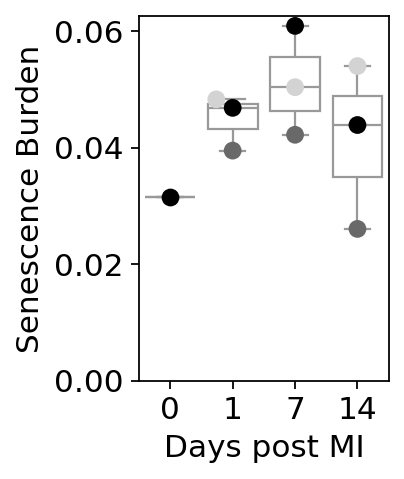

In [60]:
plt.figure(figsize=(2,3))
ax = sns.boxplot(data = df[df.condition == 'WT'], x = 'day', y = 'per', color = 'w')
ax = sns.swarmplot(data = df[df.condition == 'WT'], x = 'day', y = 'per', s = 8, hue = 'Rep',
                   palette = ['k', 'dimgrey', 'lightgrey'], legend=False)

plt.ylabel('Senescence Burden')


plt.ylim(bottom = 0)



plt.xlabel('Days post MI')

plt.savefig('figures/7F_pt5.png', dpi = 600, bbox_inches = 'tight')
plt.savefig('figures/7F_pt5.svg', bbox_inches = 'tight')


plt.show()

In [32]:
#none sig for raw contribution count of outliers
day0 = df.loc[df['day'] == 0]['per']
day1 = df.loc[df['day'] == 1]['per']
day7 = df.loc[df['day'] == 7]['per']
day14 = df.loc[df['day'] == 14]['per']

#one-way ANOVA
#f_statistic, p_value = stats.f_oneway( day1, day7, day14)
print(stats.f_oneway(day0, day1, day7, day14))

F_onewayResult(statistic=1.400082554006558, pvalue=0.2993688391998383)


In [33]:
'''
Returns Moran I statistics for a spatial object.

adata must have:
obs column array_row
obs column array_col

will first check obs for obs_value, then check var_names - still need to add this

mi.p_norm
mi.I

'''


def spatial_ac(adata, obs_value, ethresh = 3):
    spots = np.vstack((adata.obs.index, adata.obs.array_row.values, adata.obs.array_col.values)).T.tolist()
    pairs = list(itertools.combinations(spots,2))
    
    def get_edis(spot1, spot2): #((x,y),(x,y))
        return math.sqrt((spot1[0] - spot2[0])**2 + (spot1[1] - spot2[1])**2)

    out = []
    for pair in pairs:
        spot1, spot2 = pair
        out.append([spot1[0], spot2[0], get_edis((spot1[1],spot1[2]), (spot2[1],spot2[2]))])
        
    dists  = np.array([x for x in out if x[2] <= ethresh]) #only keep those closer than or equal to 3
    
    bcs = np.unique(dists[:,0:2]) #unique BCs
    
    #add neighbors and weights
    #neighbors: {'a':['b'],'b':['a','c'],'c':['b']}
    #weights: {'a':[0.5],'b':[0.5,1.5],'c':[1.5]}
    neighbors = {}
    weights = {}
    for bc in bcs:
        temp_n = []
        temp_w = []
        temp = dists[(dists[:,0] == bc) | (dists[:,1] == bc)]
        for row in temp.tolist():
            a,b,c = row
            if a == bc:
                temp_n.append(b)
            else:
                temp_n.append(a)
            temp_w.append(1/float(c)) ####weight is 1/e distance
        neighbors[bc] = temp_n
        weights[bc] = temp_w
        
    w = pysal.lib.weights.W(neighbors, weights = weights)     
    y_vals = dict(zip(adata.obs.index, adata.obs[obs_value]))
    y = np.vectorize(y_vals.get)(bcs)
    
    return esda.Moran(y, w, two_tailed = False)
    

In [34]:
#spatial autocorrelation for the different hubs

#should prob add more stuff like how many out at each
out = []
for hub in list(heart_hubs):
    the_col_name = '__'.join([str(x) for x in hub])
    print(the_col_name)
    for adata in tqdm(adatas):
        res = spatial_ac(adatas[adata], the_col_name, ethresh = 2)
        
        num_sen_like = len(adatas[adata].obs[adatas[adata].obs[the_col_name + '_out'].astype(int) > 0])
        num_tot = len(adatas[adata])
        
        
        i = np.where(adatas[adata].var_names == 'Col1a1')[0][0]
        a = adatas[adata].X[:,i].toarray().flatten()
        pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
        
        
        if 'day' in adata:
            day = adata.split('day')[1].split('_')[0]
            day = int(day)
        else:
            day = 0
            
        if '_WT_' in adata:
            cond = 'WT'
        elif 'shCsrp3' in adata:
            cond = 'shCsrp3'
        else:
            cond = 'Csrp3OE'
        
        
        
        
        out.append([cond, day, the_col_name, adata,
                    res.I, res.p_z_sim, res.p_sim, num_sen_like, num_tot, pear.statistic, pear.pvalue])

Heart_and_Aorta__endocardial cell__0


  0%|                                                    | 0/14 [00:00<?, ?it/s]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
  7%|███▏                                        | 1/14 [00:02<00:37,  2.90s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 14%|██████▎                                     | 2/14 [00:07<00:43,  3.65s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:11<00:44,  4.00s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpy

Heart_and_Aorta__endocardial cell__1


  0%|                                                    | 0/14 [00:00<?, ?it/s]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
  7%|███▏                                        | 1/14 [00:02<00:31,  2.41s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 14%|██████▎                                     | 2/14 [00:06<00:42,  3.54s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:10<00:38,  3.49s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpy

Heart_and_Aorta__endothelial cell__0


  0%|                                                    | 0/14 [00:00<?, ?it/s]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:08<00:33,  3.02s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
 36%|███████████████▋                            | 5/14 [00:22<00:50,  5.56s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 43%|██████████████████▊                         | 6/14 [00:24<00:36,  4.55s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-pa

Heart_and_Aorta__fibroblast__0


 21%|█████████▍                                  | 3/14 [00:08<00:32,  2.92s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
 36%|███████████████▋                            | 5/14 [00:23<00:54,  6.05s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 43%|██████████████████▊                         | 6/14 [00:25<00:37,  4.68s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is no

Heart_and_Aorta__fibroblast__1


  7%|███▏                                        | 1/14 [00:02<00:26,  2.06s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:08<00:31,  2.90s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 36%|███████████████▋                            | 5/14 [00:22<00:53,  5.98s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
 

Heart_and_Aorta__myocyte__1


  0%|                                                    | 0/14 [00:00<?, ?it/s]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
  7%|███▏                                        | 1/14 [00:01<00:25,  2.00s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 14%|██████▎                                     | 2/14 [00:05<00:34,  2.87s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:08<00:31,  2.89s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpy

Heart_and_Aorta__myocyte__2


  0%|                                                    | 0/14 [00:00<?, ?it/s]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
  7%|███▏                                        | 1/14 [00:02<00:31,  2.42s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 14%|██████▎                                     | 2/14 [00:06<00:42,  3.51s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:11<00:43,  3.91s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpy

Heart_and_Aorta__smooth muscle cell__1


  0%|                                                    | 0/14 [00:00<?, ?it/s]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 14%|██████▎                                     | 2/14 [00:07<00:44,  3.67s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pear = stats.pearsonr(a, adatas[adata].obs[the_col_name + '_out'])
 21%|█████████▍                                  | 3/14 [00:10<00:36,  3.36s/it]/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
 36%|███████████████▋                            | 5/14 [00:27<01:05,  7.26s/it]/tmp/ipykernel_1986634/2343773726.py:17: ConstantInputWa

In [35]:
test = pd.DataFrame(out,
    columns = ['condition', 'day', 'hub', 'sample', 'I', 'p_z_sim', 'p_sim', 'num_sen', 'num_tot', 'r', 'r_p'])

test['per_sen'] = test.num_sen/test.num_tot

test['p_z'] = test['p_z_sim'].replace(0, 4.9e-324)

test['-logp'] = -np.log10(test['p_z_sim'])

In [36]:
test.sort_values('I')

,condition,day,hub,sample,I,p_z_sim,p_sim,num_sen,num_tot,r,r_p,per_sen,p_z,-logp
33,WT,0,Heart_and_Aorta__endothelial cell__0,GSM5355663_WT_Sham,0.000975,0.447335,0.430,0,1684,NaN,NaN,0.000000,4.473352e-01,0.349367
69,shCsrp3,1,Heart_and_Aorta__fibroblast__1,GSM5943196_shCsrp3_MI_day1,0.010980,0.189691,0.190,0,1410,NaN,NaN,0.000000,1.896906e-01,0.721954
34,Csrp3OE,14,Heart_and_Aorta__endothelial cell__0,GSM5943199_Csrp3OE_MI_day14,0.012423,0.166259,0.153,0,1520,NaN,NaN,0.000000,1.662587e-01,0.779216
11,WT,14,Heart_and_Aorta__endocardial cell__0,GSM5943195_WT_MI_day14_3,0.017398,0.088526,0.102,0,1390,NaN,NaN,0.000000,8.852577e-02,1.052930
56,WT,14,Heart_and_Aorta__fibroblast__1,GSM5355668_WT_MI_day14_1,0.017694,0.126620,0.131,1,1152,0.029258,3.211074e-01,0.000868,1.266198e-01,0.897498
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32,WT,7,Heart_and_Aorta__endothelial cell__0,GSM5355666_WT_MI_day7_1,0.568362,0.000000,0.001,27,3151,0.100667,1.487556e-08,0.008569,4.940656e-324,inf
87,WT,1,Heart_and_Aorta__myocyte__2,GSM5943190_WT_MI_day1_2,0.575816,0.000000,0.001,0,1553,NaN,NaN,0.000000,4.940656e-324,inf
17,WT,1,Heart_and_Aorta__endocardial cell__1,GSM5943190_WT_MI_day1_2,0.640476,0.000000,0.001,12,1553,0.004823,8.493644e-01,0.007727,4.940656e-324,inf
88,WT,7,Heart_and_Aorta__myocyte__2,GSM5355666_WT_MI_day7_1,0.722912,0.000000,0.001,63,3151,0.131818,1.094687e-13,0.019994,4.940656e-324,inf


In [37]:
test[test.day == 0]

,condition,day,hub,sample,I,p_z_sim,p_sim,num_sen,num_tot,r,r_p,per_sen,p_z,-logp
5,WT,0,Heart_and_Aorta__endocardial cell__0,GSM5355663_WT_Sham,0.097975,1.315083e-13,0.001,0,1684,NaN,NaN,0.0,1.315083e-13,12.881047
19,WT,0,Heart_and_Aorta__endocardial cell__1,GSM5355663_WT_Sham,0.146146,8.177925e-28,0.001,0,1684,NaN,NaN,0.0,8.177925e-28,27.087357
33,WT,0,Heart_and_Aorta__endothelial cell__0,GSM5355663_WT_Sham,0.000975,4.473352e-01,0.430,0,1684,NaN,NaN,0.0,4.473352e-01,0.349367
47,WT,0,Heart_and_Aorta__fibroblast__0,GSM5355663_WT_Sham,0.076510,2.542925e-09,0.001,0,1684,NaN,NaN,0.0,2.542925e-09,8.594666
61,WT,0,Heart_and_Aorta__fibroblast__1,GSM5355663_WT_Sham,0.037489,2.165399e-03,0.003,0,1684,NaN,NaN,0.0,2.165399e-03,2.664462
75,WT,0,Heart_and_Aorta__myocyte__1,GSM5355663_WT_Sham,0.160112,6.573009e-35,0.001,0,1684,NaN,NaN,0.0,6.573009e-35,34.182236
89,WT,0,Heart_and_Aorta__myocyte__2,GSM5355663_WT_Sham,0.112368,7.623064e-18,0.001,0,1684,NaN,NaN,0.0,7.623064e-18,17.117870
103,WT,0,Heart_and_Aorta__smooth muscle cell__1,GSM5355663_WT_Sham,0.079211,1.371257e-09,0.001,0,1684,NaN,NaN,0.0,1.371257e-09,8.862881


### Fig 7H

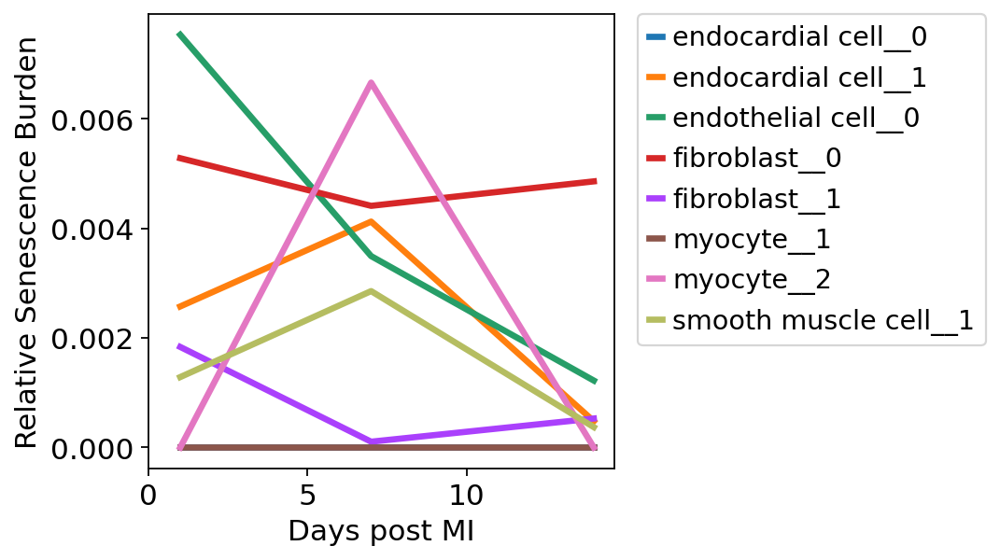

In [55]:
#plot of sen burden for each hub over time
sns.lineplot(data = test[(test.condition == 'WT') & (test.day > 0)],
             x = 'day', y = 'per_sen', hue = 'hub', lw = 3, err_style = None)



# Get the legend handles and labels
handles, labels = plt.gca().get_legend_handles_labels()


for handle in handles:
    handle.set_linewidth(3)

# Modify the labels to remove "Heart_and_aorta"
new_labels = [label.split('__', 1)[1] for label in labels]

# Update the legend with the new labels
plt.legend(handles=handles, labels=new_labels, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


plt.ylabel('Relative Senescence Burden')
plt.xlabel('Days post MI')

plt.xlim(left = 0)

#plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.savefig('figures/7H.png', dpi = 600, bbox_inches = 'tight')
plt.savefig('figures/7H.svg', bbox_inches = 'tight')

plt.show()

In [56]:
#none sig for raw contribution count of outliers
for hub in test.hub.unique():
    sub = test[test.hub == hub]
    day1 = sub.loc[sub['day'] == 1]['per_sen']
    day7 = sub.loc[sub['day'] == 7]['per_sen']
    day14 = sub.loc[sub['day'] == 14]['per_sen']

    #one-way ANOVA
    #f_statistic, p_value = stats.f_oneway( day1, day7, day14)
    print(stats.f_oneway( day1, day7, day14))

F_onewayResult(statistic=nan, pvalue=nan)
F_onewayResult(statistic=0.8686616641466105, pvalue=0.4489052232386504)
F_onewayResult(statistic=2.1684325403480673, pvalue=0.16509313276930923)
F_onewayResult(statistic=0.15229192160449076, pvalue=0.860691896119431)
F_onewayResult(statistic=0.47374455010352207, pvalue=0.6359564738775599)
F_onewayResult(statistic=nan, pvalue=nan)
F_onewayResult(statistic=1.923076923076923, pvalue=0.19649623617673456)
F_onewayResult(statistic=0.9040887175809835, pvalue=0.43559777004505057)


/tmp/ipykernel_1986634/3859509554.py:10: ConstantInputWarning: Each of the input arrays is constant; the F statistic is not defined or infinite
  print(stats.f_oneway( day1, day7, day14))


In [61]:
#correlation between fibrosis and senescence as well as senescence autocorrelation
out = []
for adata in adatas:
    print(adata)
    res = spatial_ac(adatas[adata], 'sen_like', ethresh = 2)
    
    
    i = np.where(adatas[adata].var_names == 'Col1a1')[0][0]
    a = adatas[adata].X[:,i].toarray().flatten()
    pear = stats.pearsonr(a, adatas[adata].obs.sen_like)
    print(res.p_sim, res.p_norm, '\tpearson:', pear.pvalue)
    

    if 'day' in adata:
        day = adata.split('day')[1].split('_')[0]
        day = int(day)
    else:
        day = 0

    if '_WT_' in adata:
        cond = 'WT'
    elif 'shCsrp3' in adata:
        cond = 'shCsrp3'
    else:
        cond = 'Csrp3OE'
    
    
    out.append([adata, day, cond, res.I, res.p_z_sim, res.p_sim, res.p_norm,pear.pvalue, pear.statistic])
    
    
    #sc.pl.spatial(adatas[adata], color = ['Col1a1', 'sen_like'], spot_size=40, scale_factor=1)

    

GSM5355668_WT_MI_day14_1
0.125 0.12810474337350625 	pearson: 0.2346217228694094
GSM5943189_WT_MI_day1_1
0.001 1.0885415180432528e-28 	pearson: 0.5219443905374552
GSM5943191_WT_MI_day1_3
0.001 1.0437264354004122e-16 	pearson: 0.0018582102889646314
GSM5943190_WT_MI_day1_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


0.001 2.3840406146243016e-64 	pearson: 0.26222875181206373
GSM5355666_WT_MI_day7_1
0.001 0.0 	pearson: 4.174067260296618e-28
GSM5355663_WT_Sham
0.001 2.930534542597184e-10 	pearson: 0.4336586656514488
GSM5943199_Csrp3OE_MI_day14
0.001 2.4498469032379927e-43 	pearson: 6.699732955360472e-23
GSM5943198_Csrp3OE_MI_day1
0.001 4.2995711823366174e-15 	pearson: 0.08705850652003976
GSM5943192_WT_MI_day7_2
0.001 2.771330795035193e-24 	pearson: 3.148373167928752e-20
GSM5943194_WT_MI_day14_2
0.001 6.493635181679581e-63 	pearson: 2.1081919840922195e-45
GSM5943197_shCsrp3_MI_day14
0.001 1.2616255505061549e-09 	pearson: 2.662576194490317e-16
GSM5943195_WT_MI_day14_3
0.001 1.2831967201457071e-37 	pearson: 4.3295375449382796e-24
GSM5943193_WT_MI_day7_3
0.001 1.1057388151516579e-51 	pearson: 2.4064373353488307e-27
GSM5943196_shCsrp3_MI_day1
0.001 3.77236722142047e-08 	pearson: 0.012100878058568803


In [62]:
sample_stats = pd.DataFrame(out, columns = ['ID', 'day', 'cond', 'I','p_z_sim', 'p_sim', 'p_norm', 'col_corr', 'r'])

In [64]:
sample_stats = sample_stats[sample_stats.cond == 'WT'].sort_values('day').reset_index(drop = True)
sample_stats

,ID,day,cond,I,p_z_sim,p_sim,p_norm,col_corr,r
0,GSM5355663_WT_Sham,0,WT,0.082110,1.094908e-10,0.001,2.930535e-10,4.336587e-01,0.019092
1,GSM5943189_WT_MI_day1_1,1,WT,0.148659,2.857590e-28,0.001,1.088542e-28,5.219444e-01,-0.016173
2,GSM5943191_WT_MI_day1_3,1,WT,0.113783,1.157682e-17,0.001,1.043726e-16,1.858210e-03,0.081603
3,GSM5943190_WT_MI_day1_2,1,WT,0.226425,2.381952e-67,0.001,2.384041e-64,2.622288e-01,-0.028467
4,GSM5355666_WT_MI_day7_1,7,WT,0.399556,0.000000e+00,0.001,0.000000e+00,4.174067e-28,0.194032
5,GSM5943192_WT_MI_day7_2,7,WT,0.179775,2.575435e-24,0.001,2.771331e-24,3.148373e-20,0.298368
6,GSM5943193_WT_MI_day7_3,7,WT,0.229790,2.780991e-51,0.001,1.105739e-51,2.406437e-27,0.303722
7,GSM5355668_WT_MI_day14_1,14,WT,0.017273,1.323339e-01,0.125,1.281047e-01,2.346217e-01,0.035045
8,GSM5943194_WT_MI_day14_2,14,WT,0.210632,5.351625e-61,0.001,6.493635e-63,2.108192e-45,0.324825
9,GSM5943195_WT_MI_day14_3,14,WT,0.183708,5.612807e-36,0.001,1.283197e-37,4.329538e-24,0.266845


In [66]:
sample_stats['Rep'] = sample_stats['ID'].map(lambda x: x.split('_')[-1])
sample_stats = sample_stats.sort_values('ID')
sample_stats

,ID,day,cond,I,p_z_sim,p_sim,p_norm,col_corr,r,Rep
0,GSM5355663_WT_Sham,0,WT,0.082110,1.094908e-10,0.001,2.930535e-10,4.336587e-01,0.019092,Sham
4,GSM5355666_WT_MI_day7_1,7,WT,0.399556,0.000000e+00,0.001,0.000000e+00,4.174067e-28,0.194032,1
7,GSM5355668_WT_MI_day14_1,14,WT,0.017273,1.323339e-01,0.125,1.281047e-01,2.346217e-01,0.035045,1
1,GSM5943189_WT_MI_day1_1,1,WT,0.148659,2.857590e-28,0.001,1.088542e-28,5.219444e-01,-0.016173,1
3,GSM5943190_WT_MI_day1_2,1,WT,0.226425,2.381952e-67,0.001,2.384041e-64,2.622288e-01,-0.028467,2
2,GSM5943191_WT_MI_day1_3,1,WT,0.113783,1.157682e-17,0.001,1.043726e-16,1.858210e-03,0.081603,3
5,GSM5943192_WT_MI_day7_2,7,WT,0.179775,2.575435e-24,0.001,2.771331e-24,3.148373e-20,0.298368,2
6,GSM5943193_WT_MI_day7_3,7,WT,0.229790,2.780991e-51,0.001,1.105739e-51,2.406437e-27,0.303722,3
8,GSM5943194_WT_MI_day14_2,14,WT,0.210632,5.351625e-61,0.001,6.493635e-63,2.108192e-45,0.324825,2
9,GSM5943195_WT_MI_day14_3,14,WT,0.183708,5.612807e-36,0.001,1.283197e-37,4.329538e-24,0.266845,3


In [68]:
sc.set_figure_params(dpi_save = 600)

### Fig 7 F and G part 1-4

GSM5355663_WT_Sham


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


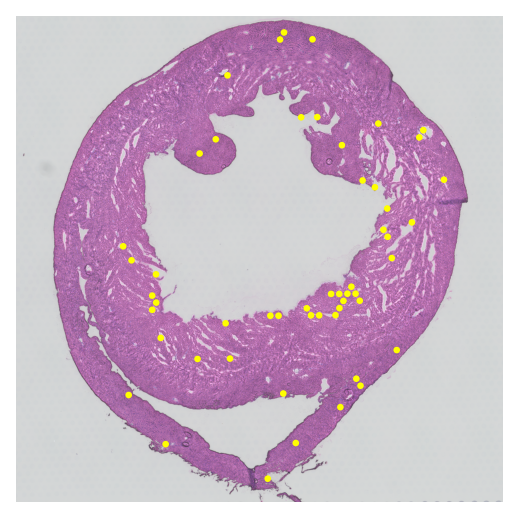

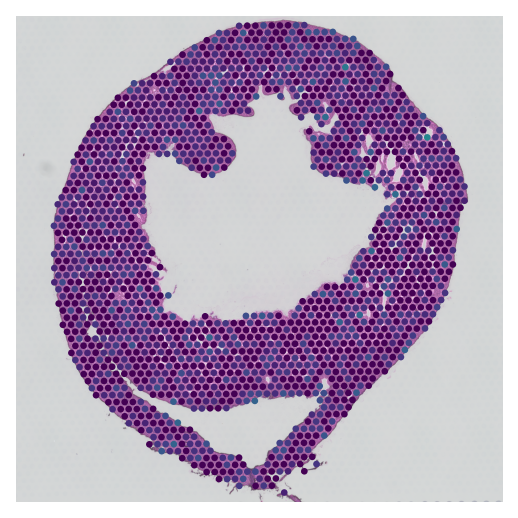

GSM5943189_WT_MI_day1_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


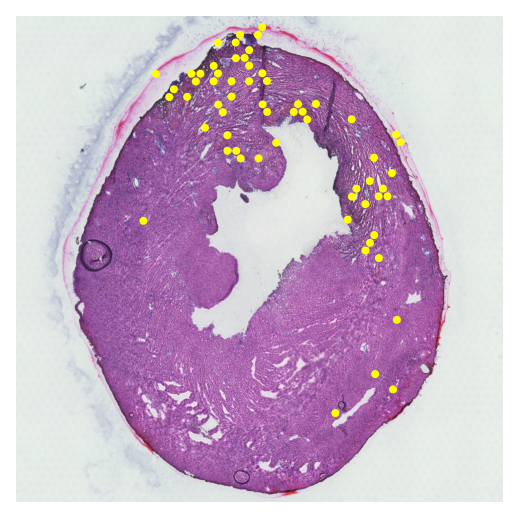

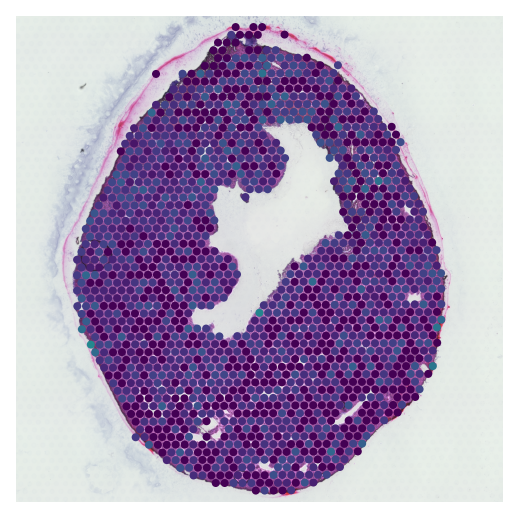

GSM5943191_WT_MI_day1_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


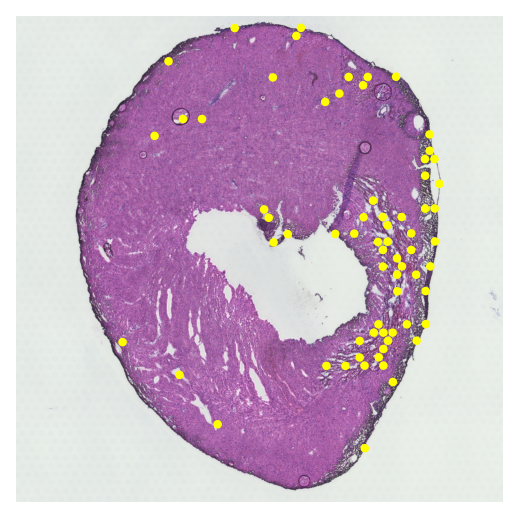

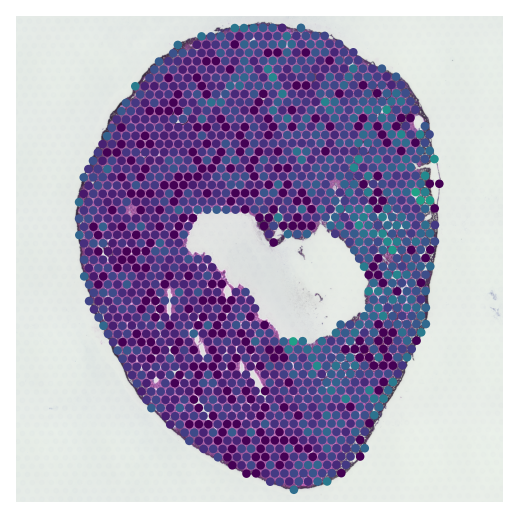

GSM5943190_WT_MI_day1_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


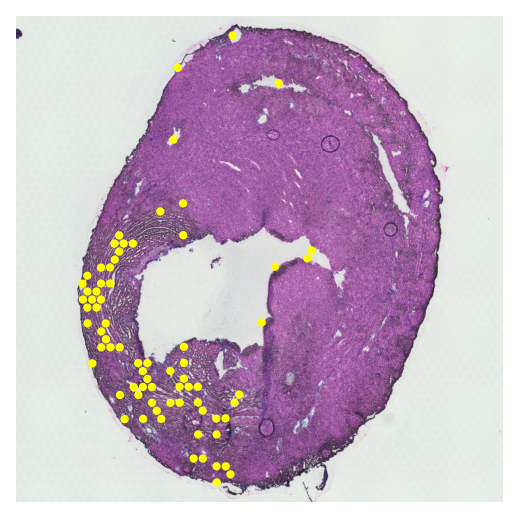

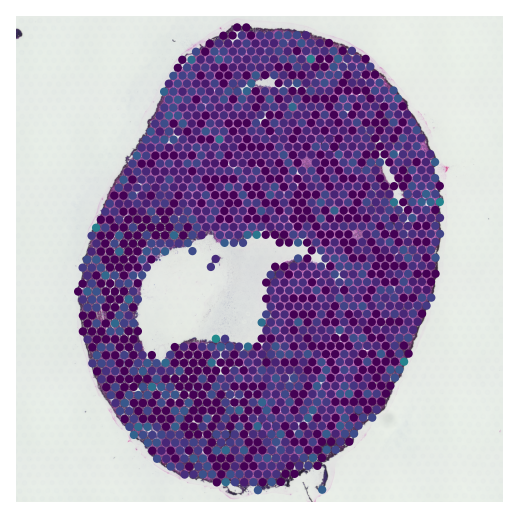

GSM5355666_WT_MI_day7_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


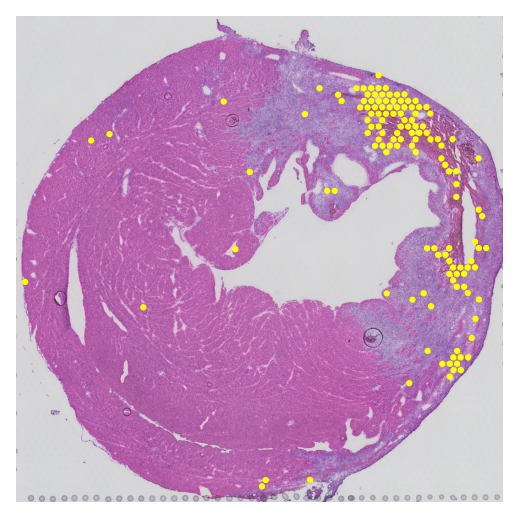

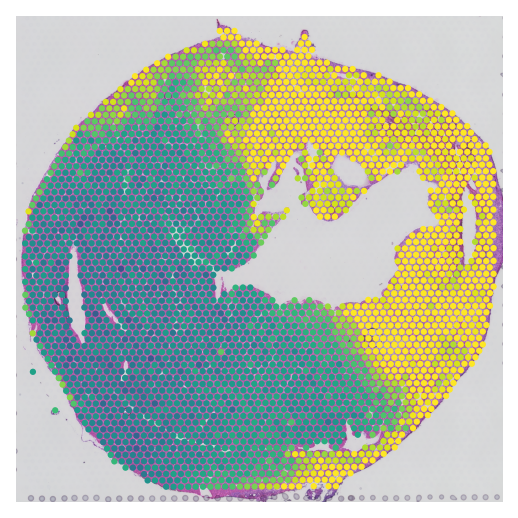

GSM5943192_WT_MI_day7_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


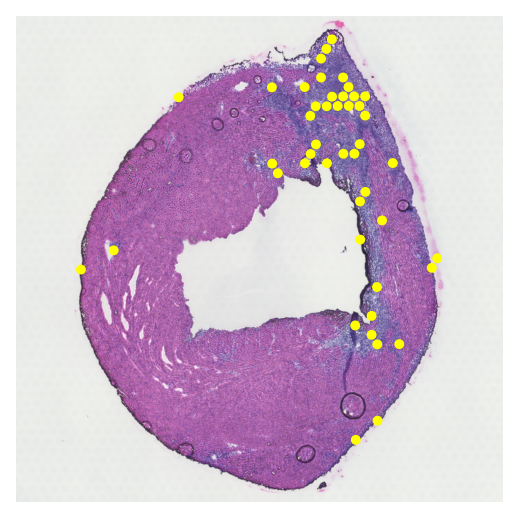

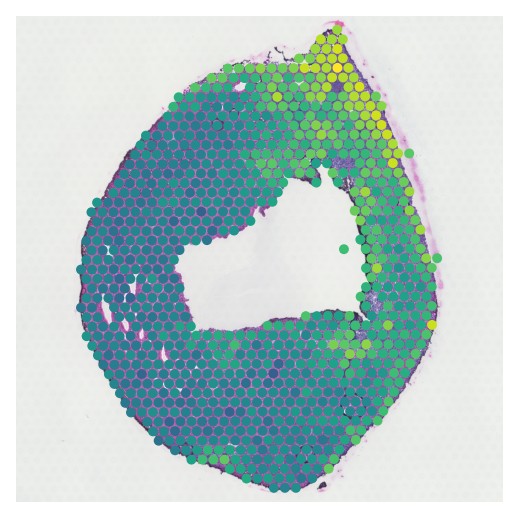

GSM5943193_WT_MI_day7_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


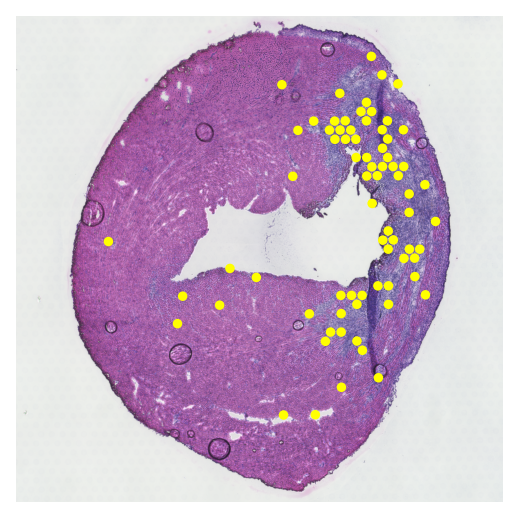

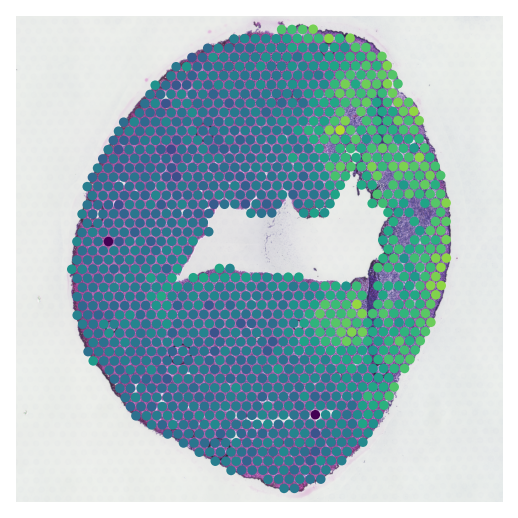

GSM5355668_WT_MI_day14_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


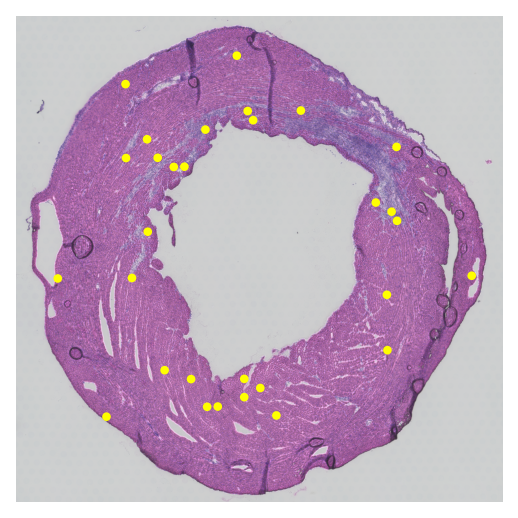

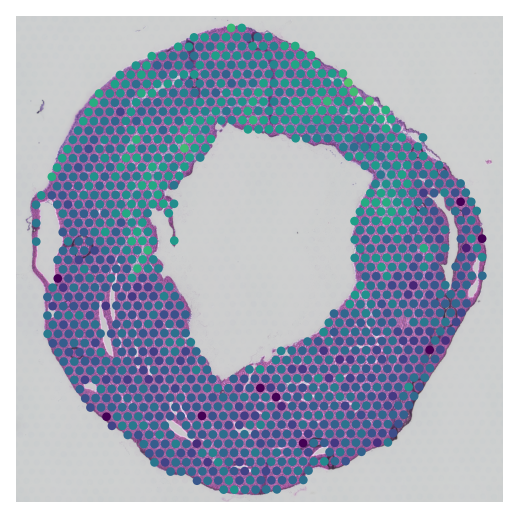

GSM5943194_WT_MI_day14_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


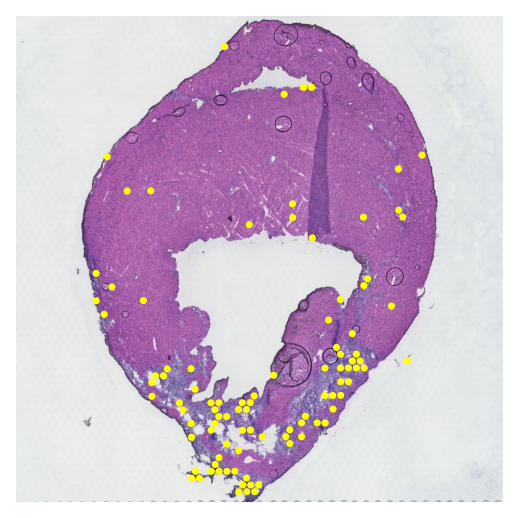

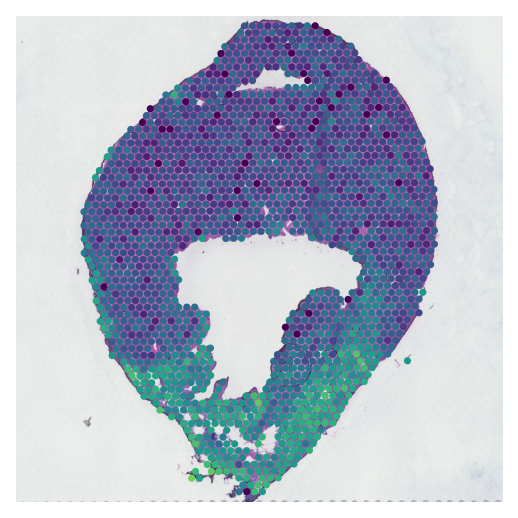

GSM5943195_WT_MI_day14_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


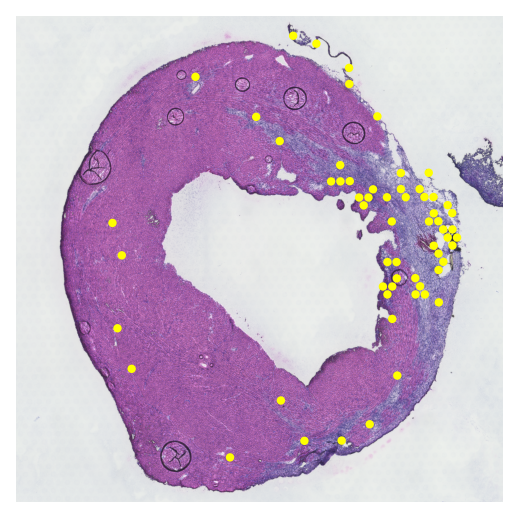

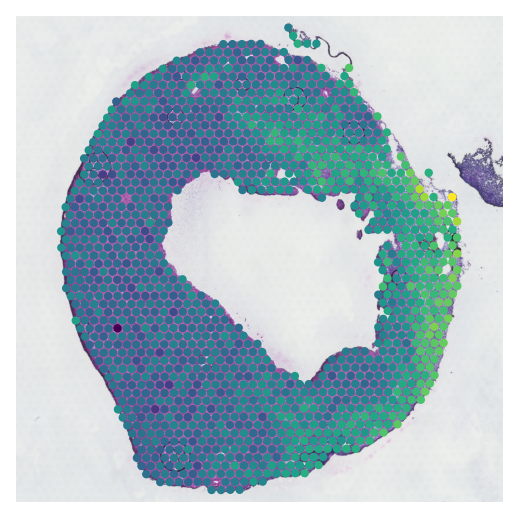

In [69]:
for i in range(len(sample_stats)):
    print(sample_stats.loc[i].ID)
    temp = adatas[sample_stats.loc[i].ID]

    im_w = temp.uns['spatial']['the_stuff']['images']['hires'].shape[1]
    im_h = temp.uns['spatial']['the_stuff']['images']['hires'].shape[0]

    extra_pad = 50

    pad_right = im_w - temp.obsm['spatial'][:,0].max() - extra_pad
    pad_left = temp.obsm['spatial'][:,0].min() - extra_pad

    pad_top = im_h - temp.obsm['spatial'][:,1].max() - extra_pad
    pad_bot = temp.obsm['spatial'][:,1].min() - extra_pad




    crop_coord = [pad_left, im_w - pad_right ,im_h - pad_top,pad_bot] #(left, right, top, bottom)
    x_len = crop_coord[1] - crop_coord[0]
    y_len = crop_coord[2] - crop_coord[3]
    if x_len > y_len:
        diff = x_len - y_len
        #add diff to both top and bot
        diff = diff //2
        crop_coord[2] += diff
        crop_coord[3] -= diff

    if y_len > x_len:
        diff = y_len - x_len
        #add diff to both right and left
        diff = diff //2
        crop_coord[0] -= diff
        crop_coord[1] += diff


    #ax = sns.lineplot(x = [10,100], y = [10,100], lw = 100, zorder = 0)
    
    sc.pl.spatial(temp[temp.obs.sen_like == 1], spot_size=35, scale_factor=1,
                     legend_loc = None, title = '', frameon=False, color = 'sen_like', 
                      crop_coord = tuple(crop_coord),
                 palette = ['yellow'], save = sample_stats.loc[i].ID + '_sen_spots_7F.png')
    #add_outline = True, outline_width = (0.75, 0),
    
    
    
    sc.pl.spatial(temp, spot_size=35, scale_factor=1,
                     legend_loc = None, title = '', frameon=False, color = ['Col1a1'], 
                      crop_coord = tuple(crop_coord), vmin = 0, vmax = 6, colorbar_loc = None,
                 save = sample_stats.loc[i].ID + '_col1a_7G.png')



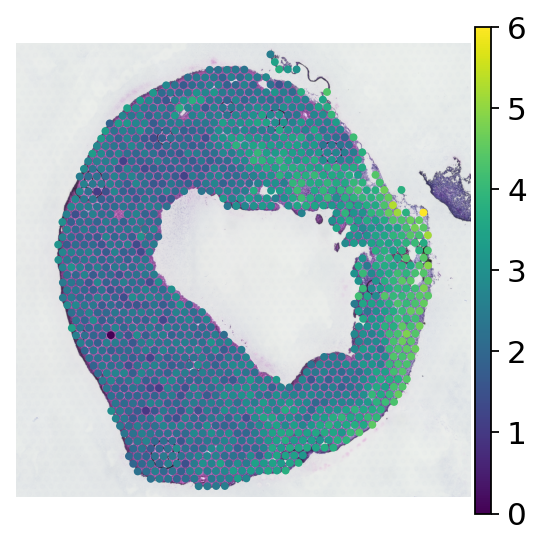

In [70]:
    sc.pl.spatial(temp, spot_size=35, scale_factor=1,
                     legend_loc = None, title = '', frameon=False, color = ['Col1a1'], 
                      crop_coord = tuple(crop_coord), vmin = 0, vmax = 6,
                 save = sample_stats.loc[i].ID + '_col1a_CBAR_7G.png')

In [71]:
sample_stats

,ID,day,cond,I,p_z_sim,p_sim,p_norm,col_corr,r,Rep
0,GSM5355663_WT_Sham,0,WT,0.082110,1.094908e-10,0.001,2.930535e-10,4.336587e-01,0.019092,Sham
4,GSM5355666_WT_MI_day7_1,7,WT,0.399556,0.000000e+00,0.001,0.000000e+00,4.174067e-28,0.194032,1
7,GSM5355668_WT_MI_day14_1,14,WT,0.017273,1.323339e-01,0.125,1.281047e-01,2.346217e-01,0.035045,1
1,GSM5943189_WT_MI_day1_1,1,WT,0.148659,2.857590e-28,0.001,1.088542e-28,5.219444e-01,-0.016173,1
3,GSM5943190_WT_MI_day1_2,1,WT,0.226425,2.381952e-67,0.001,2.384041e-64,2.622288e-01,-0.028467,2
2,GSM5943191_WT_MI_day1_3,1,WT,0.113783,1.157682e-17,0.001,1.043726e-16,1.858210e-03,0.081603,3
5,GSM5943192_WT_MI_day7_2,7,WT,0.179775,2.575435e-24,0.001,2.771331e-24,3.148373e-20,0.298368,2
6,GSM5943193_WT_MI_day7_3,7,WT,0.229790,2.780991e-51,0.001,1.105739e-51,2.406437e-27,0.303722,3
8,GSM5943194_WT_MI_day14_2,14,WT,0.210632,5.351625e-61,0.001,6.493635e-63,2.108192e-45,0.324825,2
9,GSM5943195_WT_MI_day14_3,14,WT,0.183708,5.612807e-36,0.001,1.283197e-37,4.329538e-24,0.266845,3


In [74]:
import matplotlib as mpl
mpl.rcdefaults()

### Fig 7I

/tmp/ipykernel_1986634/4063714570.py:7: UserWarning: 
The palette list has fewer values (3) than needed (4) and will cycle, which may produce an uninterpretable plot.
  ax = sns.swarmplot(data = sample_stats, x = 'day', y = 'nlog10_p_norm', s = 8, hue = 'Rep',


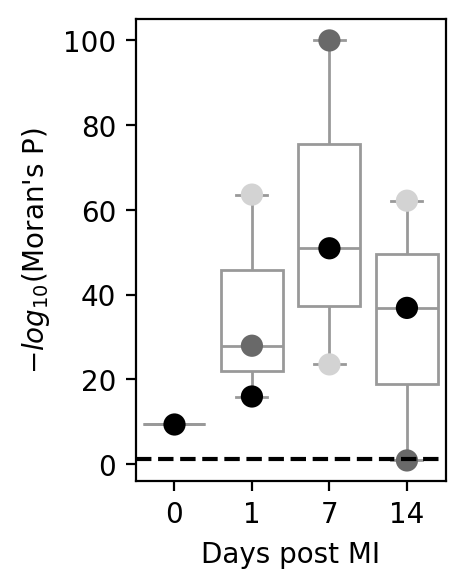

In [77]:
#autocorrelation
sample_stats['p_norm'] = sample_stats['p_norm'].replace(0,1e-100) #cuttof at 1e-100
sample_stats['nlog10_p_norm'] = -np.log10(sample_stats.p_norm)

plt.figure(figsize=(2,3))
ax = sns.boxplot(data = sample_stats, x = 'day', y = 'nlog10_p_norm', color = 'w')
ax = sns.swarmplot(data = sample_stats, x = 'day', y = 'nlog10_p_norm', s = 8, hue = 'Rep',
                  palette = ['k', 'dimgrey', 'lightgrey'], legend=False)

plt.axhline(-np.log10(0.05), ls = '--', c = 'k', zorder = 3)

plt.ylabel(r"$-log_{10}$(Moran's P)")
#plt.ylabel(r"$\mathbf{-log_{10}}$(Moran's P)", weight='bold')

plt.xlabel('Days post MI')

plt.savefig('figures/7I.png', dpi = 600, bbox_inches = 'tight')
plt.savefig('figures/7I.svg', bbox_inches = 'tight')

plt.show()

### Fig 7G part 5

/tmp/ipykernel_1986634/3190277192.py:6: UserWarning: 
The palette list has fewer values (3) than needed (4) and will cycle, which may produce an uninterpretable plot.
  ax = sns.swarmplot(data = sample_stats, x = 'day', y = 'nlog10_col', s = 8,  hue = 'Rep',


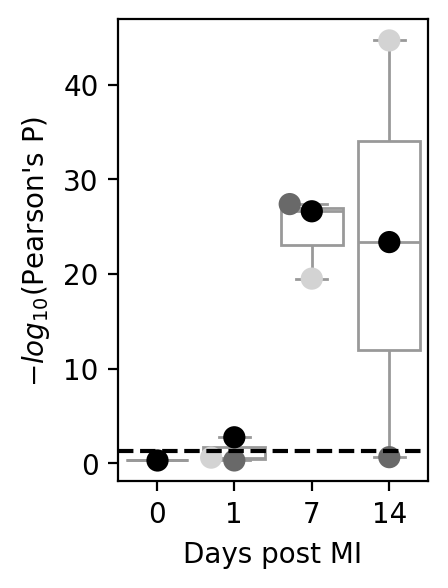

In [80]:
#col corr
sample_stats['nlog10_col'] = -np.log10(sample_stats.col_corr)

plt.figure(figsize=(2,3))
ax = sns.boxplot(data = sample_stats, x = 'day', y = 'nlog10_col', color = 'w')
ax = sns.swarmplot(data = sample_stats, x = 'day', y = 'nlog10_col', s = 8,  hue = 'Rep',
                   palette = ['k', 'dimgrey', 'lightgrey'], legend=False)

plt.axhline(-np.log10(0.05), ls = '--', c = 'k', zorder = 3)

plt.ylabel(r"$-log_{10}$(Pearson's P)")
#plt.ylabel(r"$\mathbf{-log_{10}}$(Moran's P)", weight='bold')


plt.xlabel('Days post MI')

plt.savefig('figures/7G_pt5.png', dpi = 600, bbox_inches = 'tight')
plt.savefig('figures/7G_pt5.svg', bbox_inches = 'tight')

plt.show()

In [81]:
sample_stats

,ID,day,cond,I,p_z_sim,p_sim,p_norm,col_corr,r,Rep,nlog10_p_norm,nlog10_col
0,GSM5355663_WT_Sham,0,WT,0.082110,1.094908e-10,0.001,2.930535e-10,4.336587e-01,0.019092,Sham,9.533053,0.362852
4,GSM5355666_WT_MI_day7_1,7,WT,0.399556,0.000000e+00,0.001,1.000000e-100,4.174067e-28,0.194032,1,100.000000,27.379441
7,GSM5355668_WT_MI_day14_1,14,WT,0.017273,1.323339e-01,0.125,1.281047e-01,2.346217e-01,0.035045,1,0.892435,0.629632
1,GSM5943189_WT_MI_day1_1,1,WT,0.148659,2.857590e-28,0.001,1.088542e-28,5.219444e-01,-0.016173,1,27.963155,0.282376
3,GSM5943190_WT_MI_day1_2,1,WT,0.226425,2.381952e-67,0.001,2.384041e-64,2.622288e-01,-0.028467,2,63.622686,0.581320
2,GSM5943191_WT_MI_day1_3,1,WT,0.113783,1.157682e-17,0.001,1.043726e-16,1.858210e-03,0.081603,3,15.981413,2.730905
5,GSM5943192_WT_MI_day7_2,7,WT,0.179775,2.575435e-24,0.001,2.771331e-24,3.148373e-20,0.298368,2,23.557312,19.501914
6,GSM5943193_WT_MI_day7_3,7,WT,0.229790,2.780991e-51,0.001,1.105739e-51,2.406437e-27,0.303722,3,50.956347,26.618625
8,GSM5943194_WT_MI_day14_2,14,WT,0.210632,5.351625e-61,0.001,6.493635e-63,2.108192e-45,0.324825,2,62.187512,44.676090
9,GSM5943195_WT_MI_day14_3,14,WT,0.183708,5.612807e-36,0.001,1.283197e-37,4.329538e-24,0.266845,3,36.891707,23.363558


# Confirmation of autocorrelation in brain

In [82]:

with open('../data/gene_lists/mouse_markers.txt') as f:
    markers = list(f)
markers = [x for x in markers if not x.startswith('#') and ':' in x]
markers = dict(map(lambda x: x.strip().split(':'), markers)) #dict marker:role

senmayo = pd.read_csv('../data/gene_lists/senMayo.csv')['Gene(human)'].values.tolist() #FIX MOUSE
senmayo = [x[0] + x[1:].lower() for x in senmayo]
senmayo = [x for x in senmayo if x not in list(markers)]
senmayo = {x:'senmayo' for x in senmayo}
markers = markers | senmayo

In [83]:
#no brain signature so creating a signature for top 100
alls = []
for hub in hubs.hubs:
    alls += [x[0] for x in hubs.hubs[hub]]
    
nr = list(set(alls))

out = []
for gene in nr:
    out.append([gene, alls.count(gene)])

In [84]:
counts = pd.DataFrame(out, columns = ['gene', 'count']).sort_values('count', ascending = False)
counts = counts[0:150]
counts

,gene,count
6402,Hba-a1,26
7823,Hbb-b1,19
7729,Gm11428,18
7188,Saa3,18
7585,Vsig4,17
...,...,...
7843,Hcst,7
78,Ciita,7
8210,Sftpc,7
6541,Adora2a,7


In [85]:
uni_hub = list(zip(counts.gene, counts['count']))

In [91]:
def preprocess(y):
    
    dirp, qc = y
    
    dirp = '../../workstation_upload/spatial/lps/' + dirp
    
    h5 = [x for x in os.listdir(dirp) if x.endswith('h5')][0]
    
    adata = sc.read_visium(dirp, count_file=h5)
    adata.var_names_make_unique()
    
    print(f'{dirp} {len(adata)}')

    adata.var["mt"] = adata.var_names.str.startswith("mt-")
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)
    
    sc.pp.filter_cells(adata, min_counts=qc[0])
    sc.pp.filter_cells(adata, max_counts=qc[1])
    adata = adata[adata.obs["pct_counts_mt"] < 20]
    print(f"#cells after MT filter: {adata.n_obs}")
    #sc.pp.filter_genes(adata, min_cells=10)
    
    sc.pp.normalize_total(adata, inplace=True)
    sc.pp.log1p(adata)
    
    trans = sp.translator(hub = uni_hub, data = adata)
    adata.obs['uni_score'] = sp.score_hub(adata, uni_hub, translator = trans,
                                          importance = False, binarize = False)
    
    sc.tl.score_genes(adata, markers, ctrl_size=len(markers), score_name='known_score', use_raw = False)

    

    adata.obs['uni_score_out'] = (adata.obs.uni_score >\
                                           adata.obs.uni_score.mean() +\
                                           3*adata.obs.uni_score.std())*1
    
    adata.obs['known_score_out'] = (adata.obs.known_score >\
                                         adata.obs.known_score.mean() +\
                                         3*adata.obs.known_score.std())*1

    
    return adata

In [87]:
dirs = ['LPS_1', 'LPS_2','LPS_3','Saline_1','Saline_2','Saline_3']
#qcs = [(1800,55000),(200,65000),(1800,50000),(1800,45000),(1200,55000),(1500,70000)]
qcs = [(1000,65000),(1000,65000),(1000,65000),(1000,65000),(1000,65000),(1000,70000)]

In [92]:
lps_adatas = {}
for y in list(zip(dirs, qcs)):
    lps_adatas[y[0]] = preprocess(y)

/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


../../workstation_upload/spatial/lps/LPS_1 2419
#cells after MT filter: 2324


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


18 of 150 genes not initially present
10 of 18 translated
8 still not present
132/150(88.0%) genes present in data
142/150(94.67%) genes present in data after translation
Still not present: ['Hbb-b1', 'Hbb-b2', 'H2-Q8', 'Gp49a', 'Gm13315', 'Gm7609', 'Beta-s', '4931408D14Rik']


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


../../workstation_upload/spatial/lps/LPS_2 2157
#cells after MT filter: 2114


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


18 of 150 genes not initially present
10 of 18 translated
8 still not present
132/150(88.0%) genes present in data
142/150(94.67%) genes present in data after translation
Still not present: ['Hbb-b1', 'Hbb-b2', 'H2-Q8', 'Gp49a', 'Gm13315', 'Gm7609', 'Beta-s', '4931408D14Rik']


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


../../workstation_upload/spatial/lps/LPS_3 2730
#cells after MT filter: 2721


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


18 of 150 genes not initially present
10 of 18 translated
8 still not present
132/150(88.0%) genes present in data
142/150(94.67%) genes present in data after translation
Still not present: ['Hbb-b1', 'Hbb-b2', 'H2-Q8', 'Gp49a', 'Gm13315', 'Gm7609', 'Beta-s', '4931408D14Rik']


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


../../workstation_upload/spatial/lps/Saline_1 2511
#cells after MT filter: 2488


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


18 of 150 genes not initially present
10 of 18 translated
8 still not present
132/150(88.0%) genes present in data
142/150(94.67%) genes present in data after translation
Still not present: ['Hbb-b1', 'Hbb-b2', 'H2-Q8', 'Gp49a', 'Gm13315', 'Gm7609', 'Beta-s', '4931408D14Rik']


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


../../workstation_upload/spatial/lps/Saline_2 3113
#cells after MT filter: 2624


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


18 of 150 genes not initially present
10 of 18 translated
8 still not present
132/150(88.0%) genes present in data
142/150(94.67%) genes present in data after translation
Still not present: ['Hbb-b1', 'Hbb-b2', 'H2-Q8', 'Gp49a', 'Gm13315', 'Gm7609', 'Beta-s', '4931408D14Rik']


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


../../workstation_upload/spatial/lps/Saline_3 2728
#cells after MT filter: 2673


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


18 of 150 genes not initially present
10 of 18 translated
8 still not present
132/150(88.0%) genes present in data
142/150(94.67%) genes present in data after translation
Still not present: ['Hbb-b1', 'Hbb-b2', 'H2-Q8', 'Gp49a', 'Gm13315', 'Gm7609', 'Beta-s', '4931408D14Rik']


In [93]:
#manually clean up some spots not in main tissue slice
lps_adatas['LPS_2'] = lps_adatas['LPS_2'][(lps_adatas['LPS_2'].obs.array_col > 25) &\
                           (lps_adatas['LPS_2'].obs.array_row < 65)]


lps_adatas['Saline_3'] = lps_adatas['Saline_3'][lps_adatas['Saline_3'].obs.array_row > 10]

In [94]:
combined_scores = pd.concat([df.obs['uni_score'] for df in lps_adatas.values()])

combined_thresh = combined_scores.mean() + 3*combined_scores.std()

for adata in lps_adatas:
    indv_thresh = lps_adatas[adata].obs.uni_score.mean() + 3*lps_adatas[adata].obs.uni_score.std()
    
    lps_adatas[adata].obs['uni_score_out'] =\
    ((lps_adatas[adata].obs.uni_score > combined_thresh) &\
     (lps_adatas[adata].obs.uni_score > indv_thresh))*1
    
    
    lps_adatas[adata].obs['uni_score_out'] = lps_adatas[adata].obs['uni_score_out'].astype('category')

/tmp/ipykernel_1986634/2185564269.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  lps_adatas[adata].obs['uni_score_out'] =\
/tmp/ipykernel_1986634/2185564269.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  lps_adatas[adata].obs['uni_score_out'] =\


LPS_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


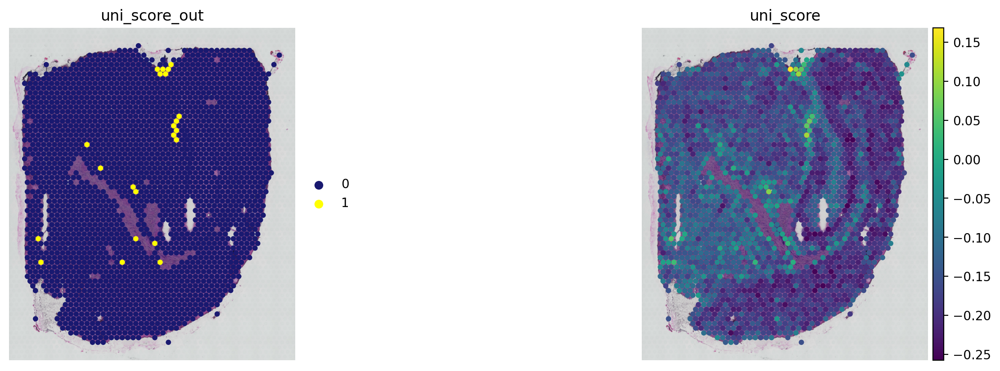

LPS_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


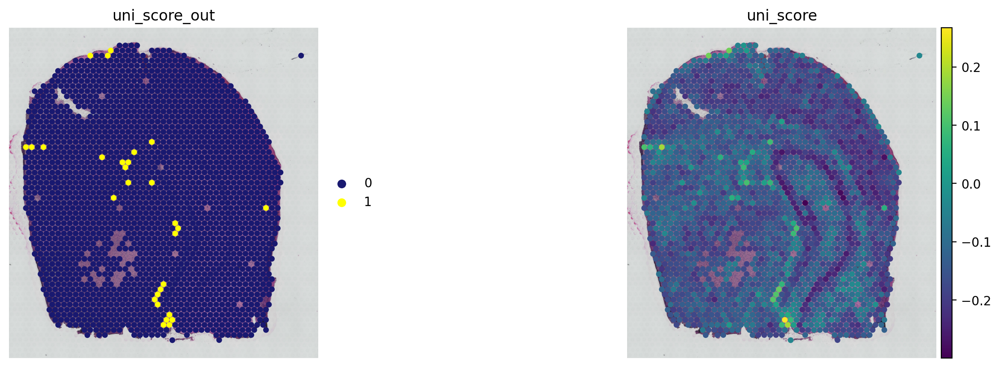

LPS_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


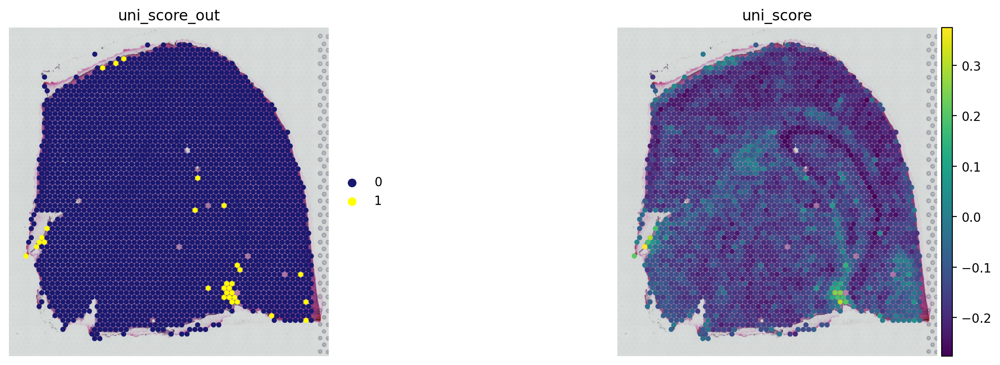

Saline_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


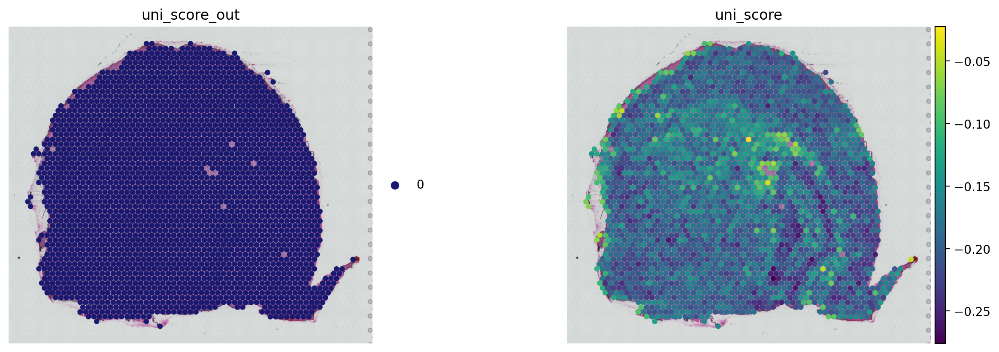

Saline_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


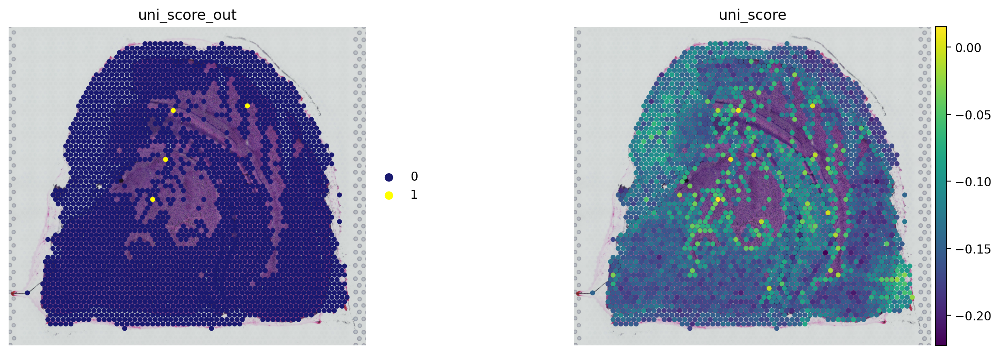

Saline_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


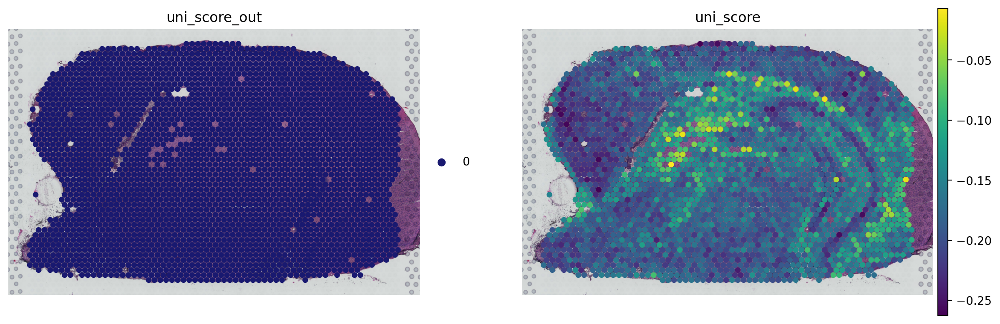

In [95]:
#correlation between fibrosis and senescence as well as senescence autocorrelation
out = []
for adata in lps_adatas:
    
    tester = 'uni_score_out'
    
    print(adata)
    res = spatial_ac(lps_adatas[adata], tester, ethresh = 3)

    if 'LPS' in adata:
        cond = 'LPS'
    else:
        cond = 'Saline'
    
    
    out.append([adata, cond, res.p_sim, res.p_norm])
    
    sc.pl.spatial(lps_adatas[adata], img_key="hires", color=[tester, 'uni_score'], size=1.5, 
                 palette = ['midnightblue','yellow'], frameon=False)

### Figure 7J

In [96]:
res = pd.DataFrame(out, columns = ['Sample', 'condition', 'p_sim', 'p_norm'])
res.p_norm = res.p_norm.replace(0, 1e-100)
res['nlog10_col'] = -np.log10(res.p_norm)

In [102]:
res = res.fillna(0)

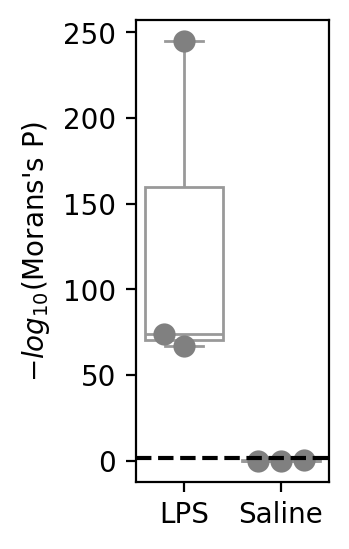

In [103]:

plt.figure(figsize=(1.25,3))
ax = sns.boxplot(data = res, x = 'condition', y = 'nlog10_col', color = 'w')
ax = sns.swarmplot(data = res, x = 'condition', y = 'nlog10_col', s = 8, color = 'grey')

plt.axhline(-np.log10(0.05), ls = '--', c = 'k', zorder = 3)

plt.ylabel(r"$-log_{10}$(Morans's P)")
#plt.ylabel(r"$\mathbf{-log_{10}}$(Moran's P)", weight='bold')

plt.xlabel('')


plt.savefig('figures/7J_pt2.png', dpi = 600, bbox_inches = 'tight')
plt.savefig('figures/7J_pt2.svg', bbox_inches = 'tight')

plt.show()

In [106]:
sc.set_figure_params(dpi_save = 600)

LPS_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


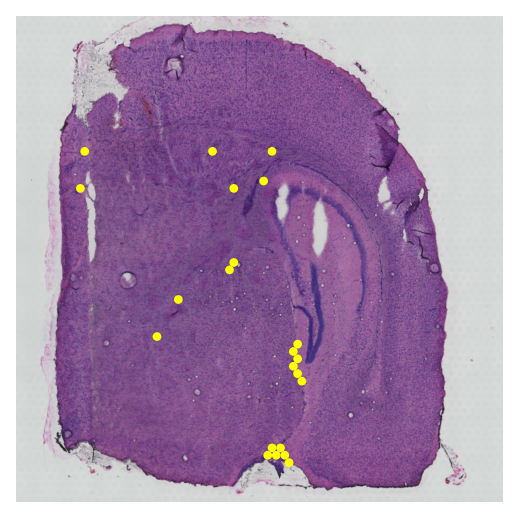

LPS_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


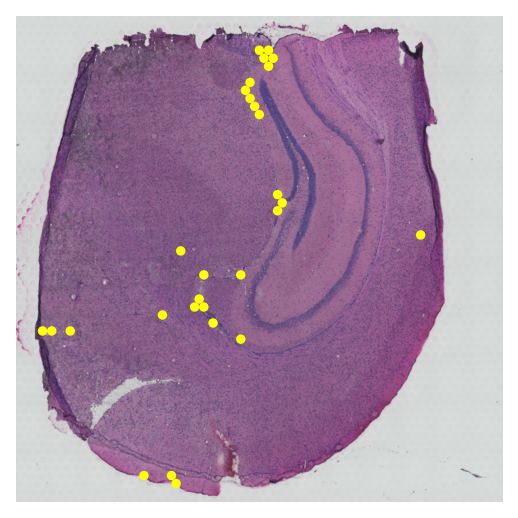

LPS_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


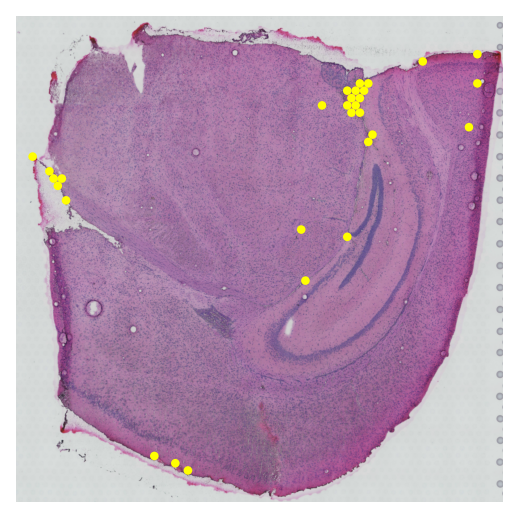

Saline_1


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


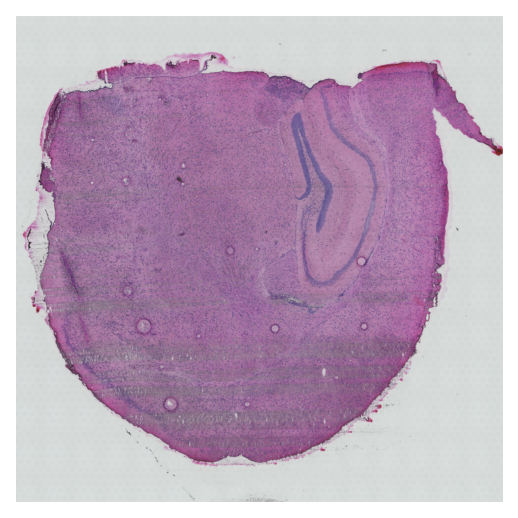

Saline_2


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


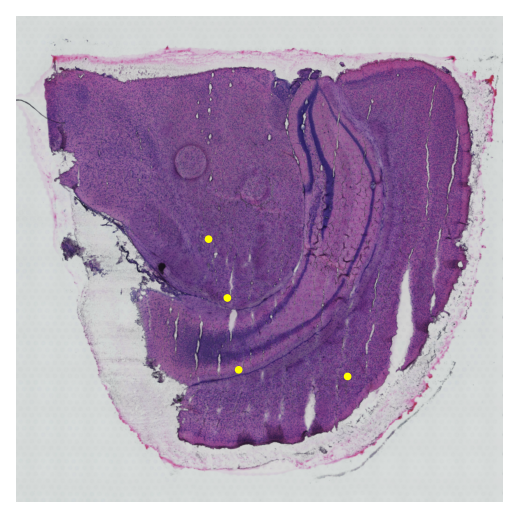

Saline_3


/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/jrlab/miniconda3/envs/senepy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


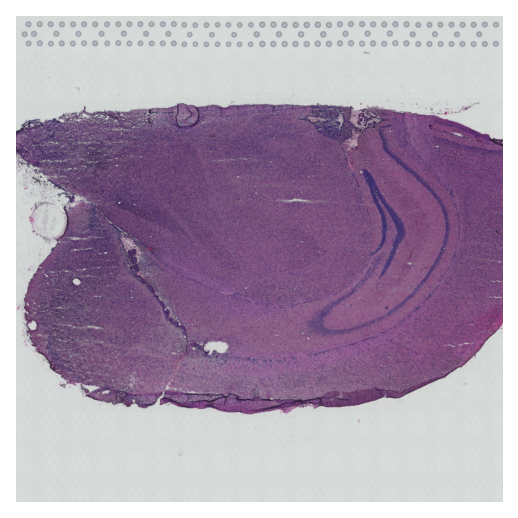

In [107]:

for adata in lps_adatas:
    
    temp = lps_adatas[adata]

    im_w = temp.uns['spatial'][list(temp.uns['spatial'])[0]]['images']['hires'].shape[1]
    im_h = temp.uns['spatial'][list(temp.uns['spatial'])[0]]['images']['hires'].shape[0]

    extra_pad = 50

    pad_right = im_w - temp.obsm['spatial'][:,0].max() - extra_pad
    pad_left = temp.obsm['spatial'][:,0].min() - extra_pad

    pad_top = im_h - temp.obsm['spatial'][:,1].max() - extra_pad
    pad_bot = temp.obsm['spatial'][:,1].min() - extra_pad




    crop_coord = [pad_left, im_w - pad_right ,im_h - pad_top,pad_bot] #(left, right, top, bottom)
    x_len = crop_coord[1] - crop_coord[0]
    y_len = crop_coord[2] - crop_coord[3]
    if x_len > y_len:
        diff = x_len - y_len
        #add diff to both top and bot
        diff = diff //2
        crop_coord[2] += diff
        crop_coord[3] -= diff

    if y_len > x_len:
        diff = y_len - x_len
        #add diff to both right and left
        diff = diff //2
        crop_coord[0] -= diff
        crop_coord[1] += diff

    print(adata)
    
    sc.pl.spatial(temp[temp.obs.uni_score_out == 1], spot_size=45,
                     legend_loc = None, title = '', frameon=False, color = 'uni_score_out', 
                      crop_coord = tuple(crop_coord),
                 palette = ['yellow'], save = '_' + adata + '_7J.png')
    
    #save = sample_stats.loc[i].ID + '_sen_spots_.png'